# This document wrangles every Room_2 dataset as a pandas dataframe.
Data Source: https://figshare.com/articles/dataset/Wireless_sensing_dataset_for_human_activity_recognition_HAR_/20444538?file=36582765

In [1]:
import os

import numpy as np 
import pandas as pd
import sympy as sp

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
import itertools

from sklearn import preprocessing
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn import cluster 
from sklearn import metrics

Overview of each dataframe:
* The data collection takes place with ONE transmitter (tx) and a receiver with THREE antennas (rx)
* 30 subcarriers (sub) are extracted per transmit receive pair
* The data is collected at 1000 samples per second. Given 10000 rows, each dataframe regards a 10 second period.
* The data is stored as complex channel state information (CSI), for each combination of tx, rx and sub for a given 0.001 second time window.
  * The complex information will be captured via its magitude and phase:
    * For example, given for 23.0+40.0j:	
        * magnitude = sqrt(23^2 + 40^2)
        * phase = atan2(40, 23)
---

### Preprocessing:

The complex number is stored as string. Therefore, we shall define a function that extracts the complex number as a numpy complex dtype.

In [2]:
def get_complex_dtypes(df):
    for col_name in df.columns:
        df[col_name] = df[col_name].str.replace(' ','')
        df[col_name] = df[col_name].str.replace('i','j')
        df[col_name] = df[col_name].apply(np.complex128)
    return df

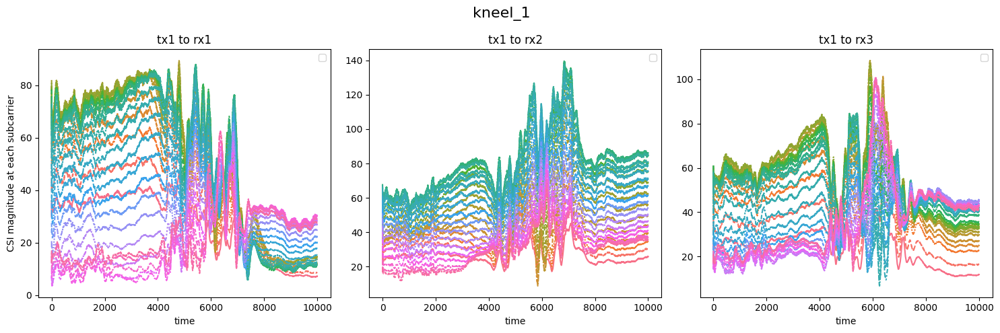

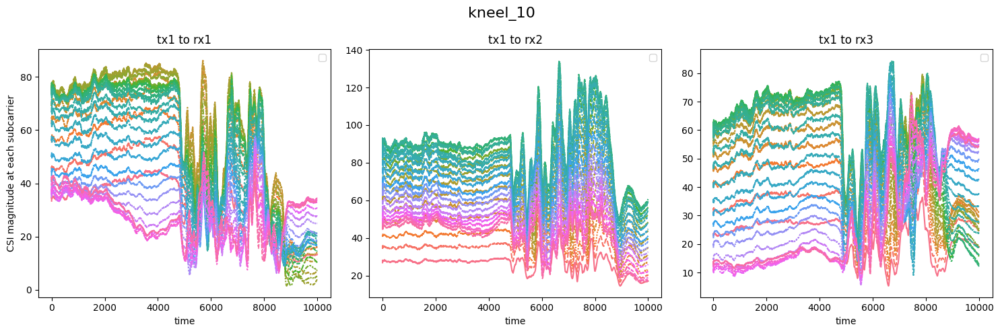

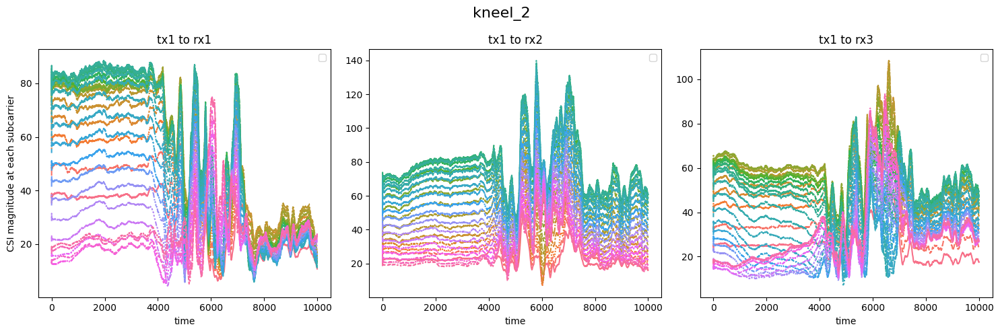

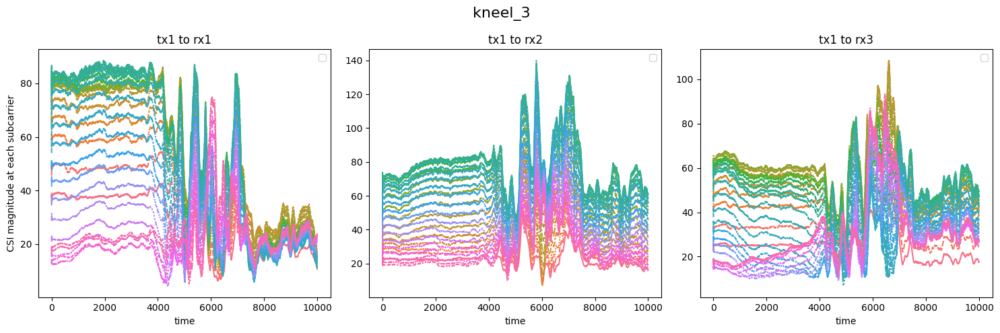

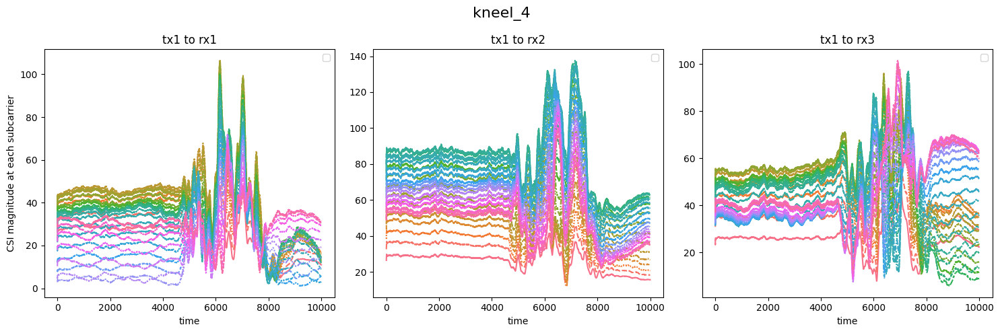

...

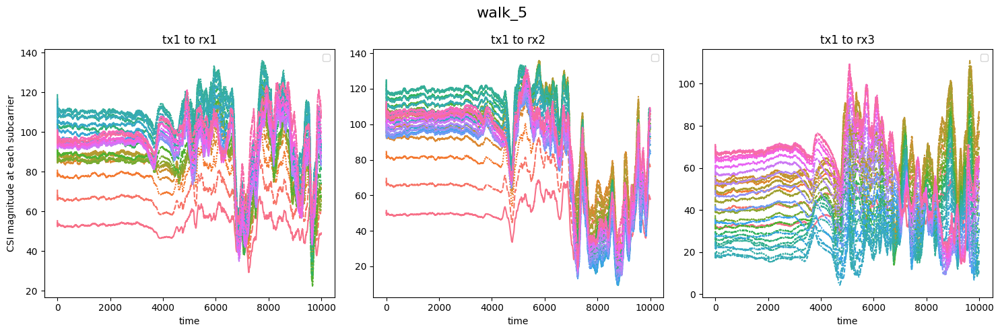

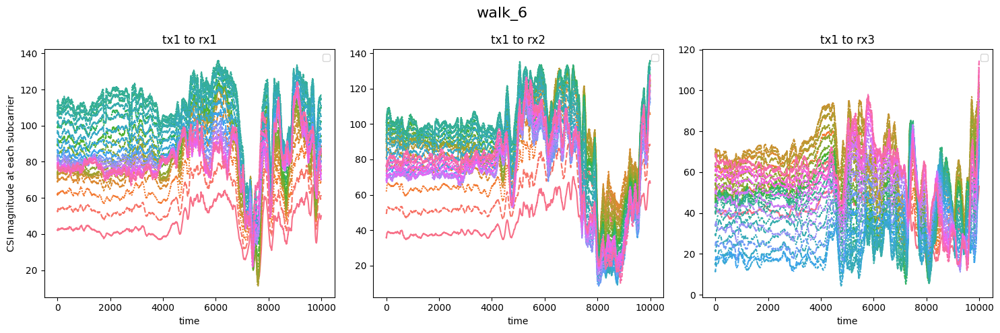

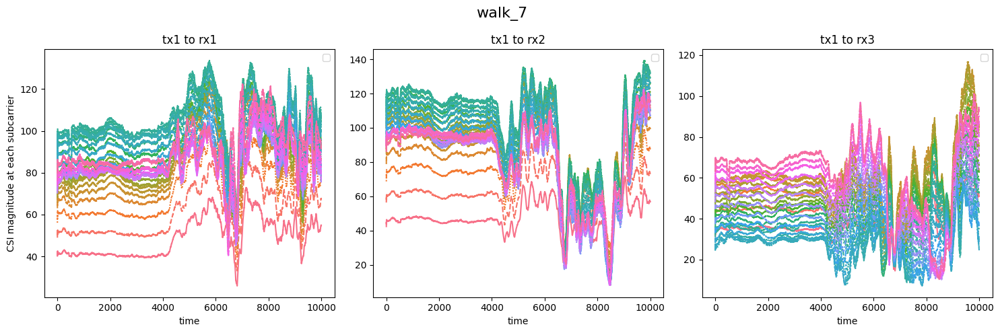

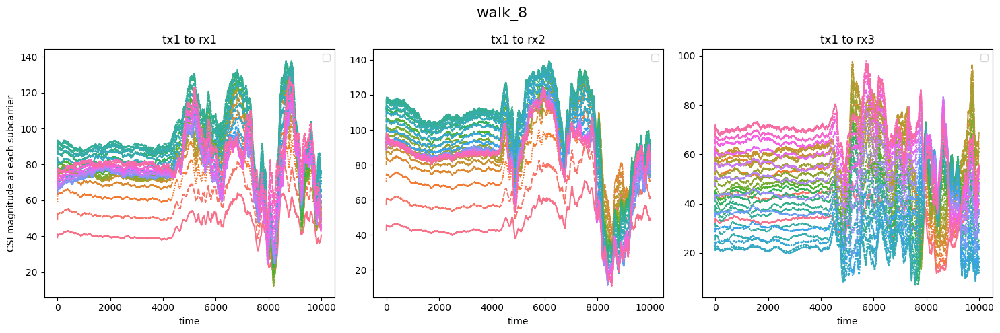

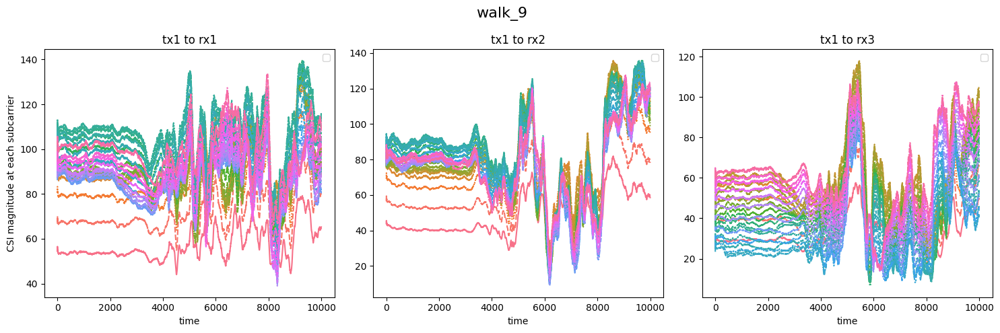

In [3]:
csv_files = os.listdir('Room2_datasets_csv') 

for csv_file in csv_files:
    df = pd.read_csv(f'Room2_datasets_csv/{csv_file}')
    df = get_complex_dtypes(df)

    df_mag = df.apply(np.abs) # magnitude
    df_ang = df.apply(np.angle) # angle
    
    plt.figure(figsize=(15, 5))
    plt.subplot(1,3,1)
    sns.lineplot(
        df_mag.rolling(window=100, min_periods=1).mean().iloc[:,:30],
        
    )
    plt.title('tx1 to rx1')
    plt.legend('')
    plt.xlabel('time')
    plt.ylabel('CSI magnitude at each subcarrier')
    
    plt.subplot(1,3,2)
    sns.lineplot(
        df_mag.rolling(window=100, min_periods=1).mean().iloc[:,30:60],
        
    )
    plt.title('tx1 to rx2')
    plt.legend('')
    plt.xlabel('time')
    
    plt.subplot(1,3,3)
    sns.lineplot(
        df_mag.rolling(window=100, min_periods=1).mean().iloc[:,60:],
        
    )
    plt.title('tx1 to rx3')
    plt.legend('')
    plt.xlabel('time')
    
    plt.suptitle(csv_file[:-4], fontsize=16)
    plt.tight_layout()
    plt.show()